# Matrices y pandas

- Fecha: 20-10-2022
- Unidad 2: ecosistema científico básico
- Temas:
    - Numpy.
    - Pandas.

- Referencias:
    - https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.imshow.html
    - https://pandas.pydata.org/pandas-docs/stable/getting_started/10min.html
    

    
## Matrices: numpy ndarray

In [2]:
import numpy as np
import plotly.graph_objects as go


from PIL import Image
#from matplotlib import pyplot as plt

### Cargamos una imagen

- Veamos su estructura

In [6]:
# leemos la imagen
i = Image.open('datos/pics/lapacho2.jpg')

# la convertimos a un array numpy
im = np.array(i)

# vemos info del archivo
print(type(im))   # tipo de contenedor
print(im.dtype)   # tipo de dato dentro del contenedor
print(im.ndim)    # dimensiones
print(im.shape)   # elementos en cada dimension

<class 'numpy.ndarray'>
uint8
3
(1280, 960, 3)


In [10]:
im = im[0:400,0:300,:]

### Visualizamos la imagen
- Ahora con plotly

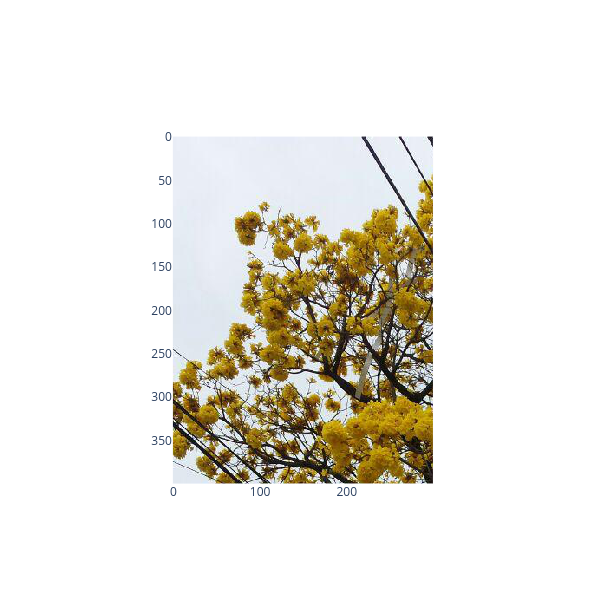

In [11]:
fig = go.Figure()
fig.add_trace(go.Image(z = im))
fig.update_layout(autosize=False, height=600)
fig.show()

### Visualizamos el valor de los pixeles

Analicemos como se muestra en valor de los pixeles de una submatriz usando slices

**Veamos el valor de un pixel específico**
- elegir un pixel interactivamente y corroborar sus valores mediante el código

In [13]:
# un pixel
colu = 239
fila = 98
banda_rojo  = float(im[fila,colu, 0])
banda_verde = float(im[fila,colu, 1])
banda_azul  = float(im[fila,colu, 2])

print(type(banda_azul))

print("rojo: " , banda_rojo)
print("verde: ", banda_verde)
print("azul: " , banda_azul)

# Primera ejercitación: calcular el promedio de los 3 valores

promedio = (banda_azul + banda_rojo + banda_verde)/3

print(promedio)

<class 'float'>
rojo:  171.0
verde:  128.0
azul:  13.0
104.0


In [15]:
im[fila,colu,:].mean()

104.0

### Ejercitación 8.1: creando el lapacho rojo

- Recorrer la imagen usando dos ciclos for anidados y cambiar el color de las flores amarillas por rojas. Ayuda: utilice el promedio

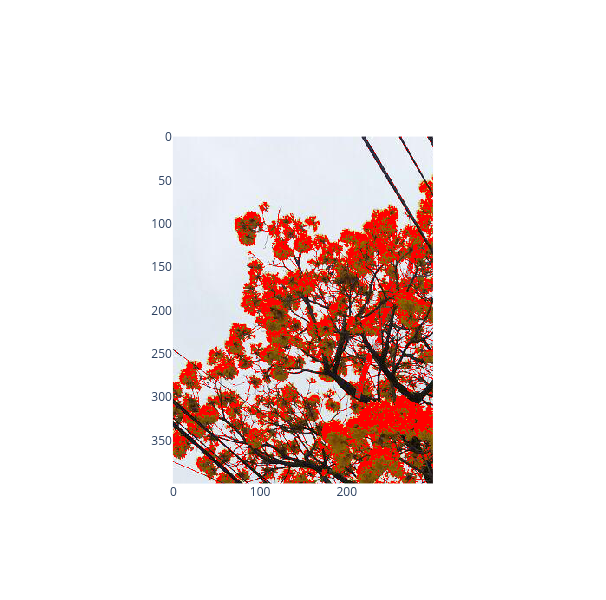

In [17]:
filas, columnas, bandas = im.shape

for f in range(filas):
    for c in range(columnas):
        # if el pixel esta en ESE rango, entonces lo cambio
        prom = im[f,c,:].mean()
        if 90 <= prom <= 150:
            im[f, c, 0] = 255 # le doy el maximo en banda ROJO
            im[f, c, 1] = 0   # 0 en banda green
            im[f, c, 2] = 0   # 0 en banda blue
            
fig = go.Figure()
fig.add_trace(go.Image(z = im))
fig.update_layout(autosize=False, height=600)
fig.show()

## Intro a Pandas

- Documentación oficial:
    - https://pandas.pydata.org/
    - https://pandas.pydata.org/pandas-docs/stable/
- Veremos:
    - conceptos generales: 
        - dataframe
        - series/columnas

### Importar pandas

In [21]:
import pandas as pd

### Dataframes a partir de un diccionario

- Creamos un dataframe a partir del diccionario previo

In [24]:
mi_rio = {"dia":    [1, 2, 3, 4, 5, 6, 7], 
          "altura": [7, 7.1, 7.2, 7.1, 7.0, 6.9, 7]}

In [25]:
mi_rio

{'dia': [1, 2, 3, 4, 5, 6, 7], 'altura': [7, 7.1, 7.2, 7.1, 7.0, 6.9, 7]}

In [23]:
rio_dataf = pd.DataFrame(mi_rio)
rio_dataf

,dia,altura
0,1,7.0
1,2,7.1
2,3,7.2
3,4,7.1
4,5,7.0
5,6,6.9
6,7,7.0


- Vemos su contenido usando los métodos .head() y .tail()

In [29]:
rio_dataf.head(3)

,dia,altura
0,1,7.0
1,2,7.1
2,3,7.2


In [31]:
rio_dataf.tail(3)

,dia,altura
4,5,7.0
5,6,6.9
6,7,7.0


In [32]:
rio_dataf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   dia     7 non-null      int64  
 1   altura  7 non-null      float64
dtypes: float64(1), int64(1)
memory usage: 240.0 bytes


In [33]:
rio_dataf.describe()

,dia,altura
count,7.000000,7.000000
mean,4.000000,7.042857
std,2.160247,0.097590
min,1.000000,6.900000
25%,2.500000,7.000000
50%,4.000000,7.000000
75%,5.500000,7.100000
max,7.000000,7.200000


**Otro ejemplo con un diccionario: con numpy ndarray**

In [43]:
t = np.linspace(-1, 1, 1000)
sin_t = np.sin(2*np.pi*t)
cos_t = np.cos(2*np.pi*t)
data_trigo = pd.DataFrame({'t': t, 'sin': sin_t, 'cos': cos_t})
data_trigo.head()

,t,sin,cos
0,-1.000000,2.449294e-16,1.000000
1,-0.997998,1.257862e-02,0.999921
2,-0.995996,2.515525e-02,0.999684
3,-0.993994,3.772789e-02,0.999288
4,-0.991992,5.029457e-02,0.998734


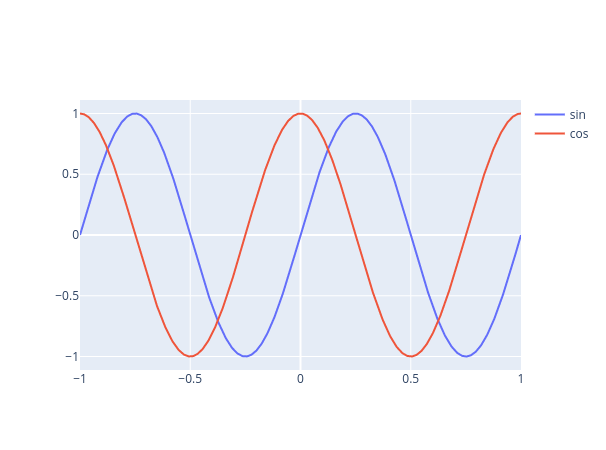

In [46]:
fig3 = go.Figure()
fig3.add_trace(go.Scatter(x=data_trigo["t"], y=data_trigo["sin"], name="sin"))
fig3.add_trace(go.Scatter(x=data_trigo["t"], y=data_trigo["cos"], name="cos"))

fig3.show()

### Ejercitación 8.2
- Grafique por separado los dataframes previos usando plotly

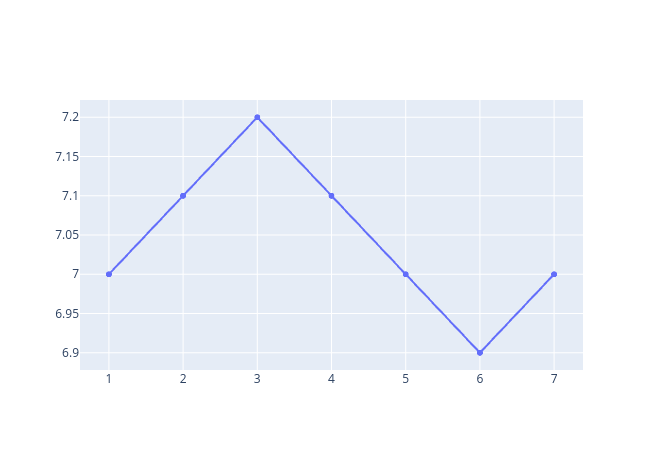

In [50]:
fig4 = go.Figure()

fig4.add_trace(go.Scattergl(x=rio_dataf["dia"], y=rio_dataf["altura"]))
fig4.show()


### Lectura desde un archivo

In [61]:
datos_eph2019 = pd.read_csv("datos/eph_pobreza2019.csv", sep=";")

In [62]:
datos_eph2019.tail()

,Regiones,Subregiones,PobrezaHogares,PobrezaPersonas,IndigenciaHogares,IndigenciaPersonas
27,Patagonia,Neuquén-Plottier,20.5,26.3,3.1,3.6
28,Patagonia,Río Gallegos,18.1,22.7,3.2,4.0
29,Patagonia,Ushuaia-Río Grande,18.1,24.0,3.1,3.9
30,Patagonia,Rawson-Trelew (3),27.8,37.5,5.4,7.4
31,Patagonia,Viedma-Carmen de Patagones,23.1,36.2,2.2,3.4


- Analizamos su tipo y contenido: **help**, parámetros importantes: sep, decimal, skiprows, names...

In [63]:
datos_eph2019.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32 entries, 0 to 31
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Regiones            32 non-null     object 
 1   Subregiones         32 non-null     object 
 2   PobrezaHogares      32 non-null     float64
 3   PobrezaPersonas     32 non-null     float64
 4   IndigenciaHogares   32 non-null     float64
 5   IndigenciaPersonas  32 non-null     float64
dtypes: float64(4), object(2)
memory usage: 1.6+ KB


In [75]:
#pd.read_csv?

In [64]:
datos_eph2019.tail()

,Regiones,Subregiones,PobrezaHogares,PobrezaPersonas,IndigenciaHogares,IndigenciaPersonas
27,Patagonia,Neuquén-Plottier,20.5,26.3,3.1,3.6
28,Patagonia,Río Gallegos,18.1,22.7,3.2,4.0
29,Patagonia,Ushuaia-Río Grande,18.1,24.0,3.1,3.9
30,Patagonia,Rawson-Trelew (3),27.8,37.5,5.4,7.4
31,Patagonia,Viedma-Carmen de Patagones,23.1,36.2,2.2,3.4


- **Métodos útiles:** .head(), .tail(), info(). describe() .rename()

In [66]:
datos_eph2019["PromePobreza"] = (datos_eph2019["PobrezaHogares"] + datos_eph2019["PobrezaPersonas"])/2

In [67]:
datos_eph2019.head()

,Regiones,Subregiones,PobrezaHogares,PobrezaPersonas,IndigenciaHogares,IndigenciaPersonas,PromePobreza
0,Gran Buenos Aires,Ciudad Autónoma de Buenos Aires,8.4,14.3,2.8,4.8,11.35
1,Gran Buenos Aires,Partidos del GBA,30.3,39.8,7.0,9.1,35.05
2,Cuyo,Gran Mendoza (3),27.3,37.6,5.1,6.6,32.45
3,Cuyo,Gran San Juan (3),20.1,30.3,3.9,6.3,25.20
4,Cuyo,Gran San Luis,25.0,34.5,1.9,2.4,29.75


<AxesSubplot:>

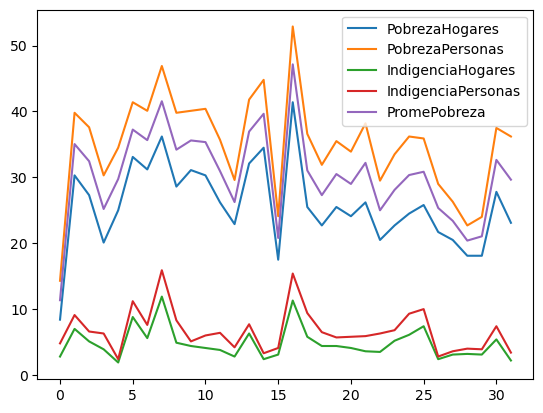

In [68]:
datos_eph2019.plot()

### Ejercitación 8.3

- Grafique el dataframe previamente cargado desde el archivo usando el método .plot
- Intente replicar el gráfico con plotly

In [72]:
datos_eph2019.plot?

In [87]:
# series apiladas
#datos_eph2019.plot()
#plt.xlabel("Subregiones")
#plt.ylabel("Porcentaje [%]")

### Selección de datos y filtrado

**Por columnas**

Tenemos dos formas de seleccionar columnas:

- **Como un diccionario:** ``data["NombreColumna"]`` <- sugerida pq es mejor!
- Como un método: ``data.NombreColumna``

Atención: revisar antes los nombres de las columnas por si tenemos espacios antes o después: ``data2.columns``

In [83]:
datos_eph2019.columns

Index(['Regiones', 'Subregiones', 'PobrezaHogares', 'PobrezaPersonas',
       'IndigenciaHogares', 'IndigenciaPersonas'],
      dtype='object')

In [57]:
datos_eph2019["Regiones"].head()

0    Gran Buenos Aires 
1    Gran Buenos Aires 
2                  Cuyo
3                  Cuyo
4                  Cuyo
Name: Regiones, dtype: object

In [59]:
datos_eph2019.Regiones.head()

0    Gran Buenos Aires 
1    Gran Buenos Aires 
2                  Cuyo
3                  Cuyo
4                  Cuyo
Name: Regiones, dtype: object

- **Podemos seleccionar columnas usando un índice numérico** ``.iloc[:,3]`` separando por comas las filas de las columnas.

In [69]:
# una única columna
datos_eph2019.iloc[:,3]

0     14.3
1     39.8
2     37.6
3     30.3
4     34.5
5     41.4
6     40.1
7     46.9
8     39.8
9     40.1
10    40.4
11    35.7
12    29.6
13    41.8
14    44.8
15    24.1
16    52.9
17    36.6
18    31.9
19    35.5
20    33.9
21    38.2
22    29.5
23    33.5
24    36.2
25    35.9
26    29.0
27    26.3
28    22.7
29    24.0
30    37.5
31    36.2
Name: PobrezaPersonas, dtype: float64

In [70]:
# o varias columnas
datos_eph2019.iloc[:,[0,3,1]]

,Regiones,PobrezaPersonas,Subregiones
0,Gran Buenos Aires,14.3,Ciudad Autónoma de Buenos Aires
1,Gran Buenos Aires,39.8,Partidos del GBA
2,Cuyo,37.6,Gran Mendoza (3)
3,Cuyo,30.3,Gran San Juan (3)
4,Cuyo,34.5,Gran San Luis
5,Noreste,41.4,Corrientes
6,Noreste,40.1,Formosa
7,Noreste,46.9,Gran Resistencia (3)
8,Noreste,39.8,Posadas
9,Noroeste,40.1,Gran Catamarca


**Por filas**

- Usando slices: ``data[1:5]``


In [71]:
datos_eph2019[5:10]

,Regiones,Subregiones,PobrezaHogares,PobrezaPersonas,IndigenciaHogares,IndigenciaPersonas,PromePobreza
5,Noreste,Corrientes,33.1,41.4,8.8,11.2,37.25
6,Noreste,Formosa,31.2,40.1,5.6,7.6,35.65
7,Noreste,Gran Resistencia (3),36.2,46.9,11.9,15.9,41.55
8,Noreste,Posadas,28.6,39.8,4.9,8.3,34.20
9,Noroeste,Gran Catamarca,31.1,40.1,4.4,5.1,35.60


- Selección de una única fila determinada

In [72]:
datos_eph2019.iloc[2] # en versiones viejas se llamaba .ix[]

Regiones                          Cuyo
Subregiones           Gran Mendoza (3)
PobrezaHogares                    27.3
PobrezaPersonas                   37.6
IndigenciaHogares                  5.1
IndigenciaPersonas                 6.6
PromePobreza                     32.45
Name: 2, dtype: object

### Crear nuevas columnas

- Es posible agregar nuevas columnas al dataframe usando una práctica similar a los diccionarios:

In [62]:
datos_eph2019["PobrezaPromedio"] = (datos_eph2019["PobrezaHogares"] + datos_eph2019["PobrezaPersonas"])/2

In [63]:
data2.head()

,Regiones,Subregiones,PobrezaHogares,PobrezaPersonas,IndigenciaHogares,IndigenciaPersonas,PobrezaPromedio
0,Gran Buenos Aires,Ciudad Autónoma de Buenos Aires,8.4,14.3,2.8,4.8,11.35
1,Gran Buenos Aires,Partidos del GBA,30.3,39.8,7.0,9.1,35.05
2,Cuyo,Gran Mendoza (3),27.3,37.6,5.1,6.6,32.45
3,Cuyo,Gran San Juan (3),20.1,30.3,3.9,6.3,25.20
4,Cuyo,Gran San Luis,25.0,34.5,1.9,2.4,29.75


In [74]:
# boolean masking / boolean indexing
indices1 = datos_eph2019["Regiones"] == "Cuyo"

In [78]:
datos_eph2019[indices1].mean()

/tmp/ipykernel_4037/3448041324.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



PobrezaHogares        24.133333
PobrezaPersonas       34.133333
IndigenciaHogares      3.633333
IndigenciaPersonas     5.100000
PromePobreza          29.133333
dtype: float64